## Song Recommender  

It allows users to provide their song preferences, in terms of the name and the released year. It also allows user to specify the number of recommendations. 

In [1]:
# Importing libraries...

import pandas as pd
import numpy as np

import plotly.express as px 
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style("whitegrid")

from pandas.plotting import scatter_matrix


from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

import random

from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.cluster import KMeans

In [2]:
# function to remove NaNs
def removeNaN(dataR_):
    data_ = dataR_.replace(np.nan,"")
    return data_

In [3]:
# import the data 
dataO= pd.read_csv("data_o.csv")

print("There are",len(dataO),"observations in the data.")
print("The columns are",list(dataO.columns))

print()
print()
print()

# To identify incomplete entries
print('Number of incomplete entries in data')
print('____________________________')
print(dataO.isna().sum())

# removing NaN values
dataO = removeNaN(dataO) 



There are 170653 observations in the data.
The columns are ['valence', 'year', 'acousticness', 'artists', 'danceability', 'duration_ms', 'energy', 'instrumentalness', 'liveness', 'loudness', 'name', 'popularity', 'speechiness', 'tempo']



Number of incomplete entries in data
____________________________
valence             0
year                0
acousticness        0
artists             0
danceability        0
duration_ms         0
energy              0
instrumentalness    0
liveness            0
loudness            0
name                0
popularity          0
speechiness         0
tempo               0
dtype: int64


## The data provide 14 attributes. However, only 11 attributes are chosen for the calculations

In [4]:
# Song features that are examined
songFeatures = ["acousticness","danceability","duration_ms","energy","instrumentalness","liveness","loudness","speechiness","tempo","valence","popularity"]

# Removing rest of the features from dataO - songData provides only the songFeatures columns
songData       = dataO[songFeatures]

#to ensure we have the correct columns
songData.dtypes

acousticness        float64
danceability        float64
duration_ms           int64
energy              float64
instrumentalness    float64
liveness            float64
loudness            float64
speechiness         float64
tempo               float64
valence             float64
popularity            int64
dtype: object

## The following figures show parameter correlations.

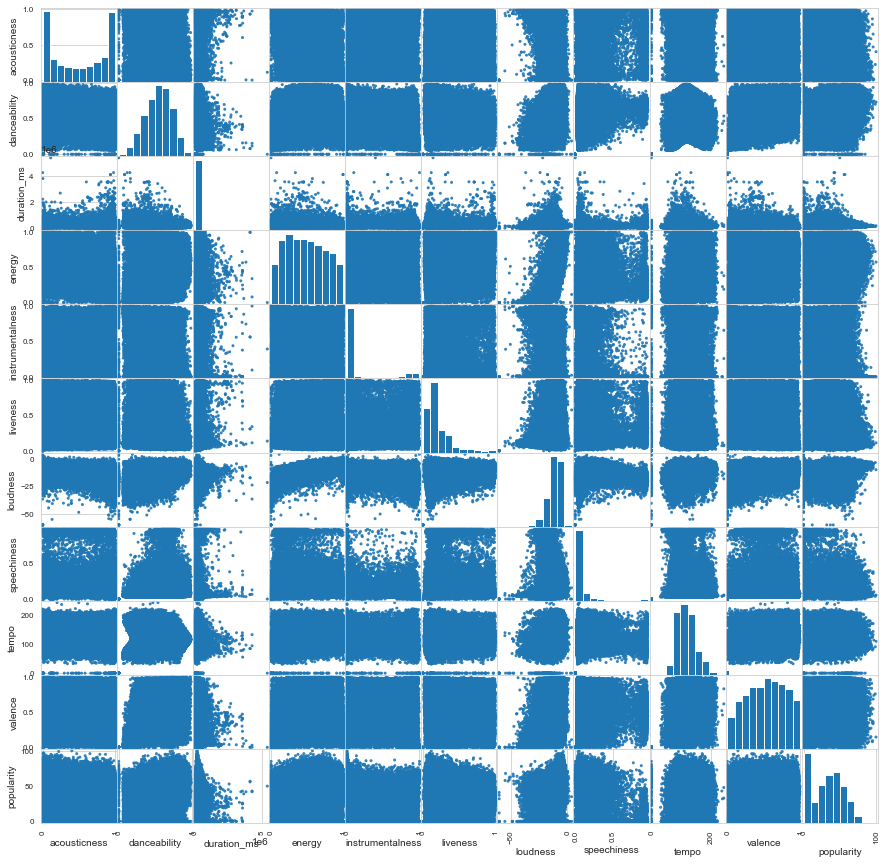

In [5]:
# Pair-wise parameter correlations based on scatter plots

scatter_matrix(songData, figsize = (15,15), alpha = 0.9)

plt.show()

## Pearson Correlation Coefficient estimate the linear correlation between parameters (i.e., covariance of the parameters normalized by the product of standard deviation). The Spearman correlation coefficient, however, can capture nonlinear behavior as long as they are monotonically varying. 

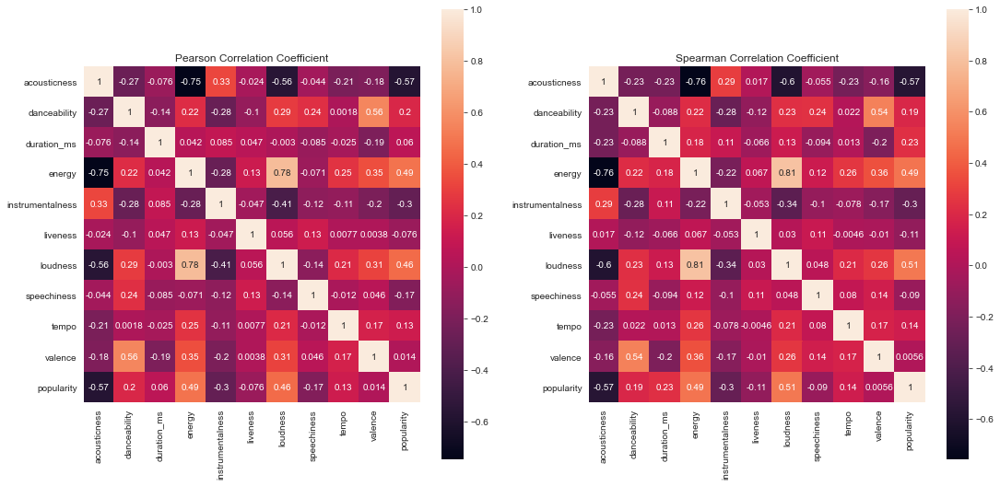

In [6]:
# Parameter correlations can also be estimated by calculating Pearson and Spearman corrlation coefficients. 


plt.figure(figsize=(18, 9))
plt.title('Comparison of Pearson and Spearman Correlation Coefficient')
plt.subplot(1,2,1)
sns.heatmap(songData.corr(), annot=True, square=True)
plt.title('Pearson Correlation Coefficient')
plt.subplot(1,2,2)
sns.heatmap(songData.corr(method = 'spearman'), annot=True, square=True)
plt.title('Spearman Correlation Coefficient')
plt.show()

## The above figures shows that there are only a few significant parameter correlations. However, we use all the song features (songFeatures) for the rest of the calculations

In [7]:
#  We introduce a pipeline to conduct KMeans clustering. We divide all the data to 20 clusters based on their song features. 
cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20))],verbose=True)

X = songData
cluster_pipeline.fit(X)
cluster_labels = cluster_pipeline.predict(X)
dataO['New Clusters'] = cluster_labels

[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.1s
[Pipeline] ............ (step 2 of 2) Processing kmeans, total=  38.3s


## We added a column titled "New clusters" to the dataO dataFrame. 

In [8]:
dataO

,valence,year,acousticness,artists,danceability,duration_ms,energy,instrumentalness,liveness,loudness,name,popularity,speechiness,tempo,New Clusters
0,0.0594,1921,0.98200,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0.878000,0.6650,-20.096,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,0.0366,80.954,15
1,0.9630,1921,0.73200,['Dennis Day'],0.819,180533,0.341,0.000000,0.1600,-12.441,Clancy Lowered the Boom,5,0.4150,60.936,11
2,0.0394,1921,0.96100,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0.913000,0.1010,-14.850,Gati Bali,5,0.0339,110.339,15
3,0.1650,1921,0.96700,['Frank Parker'],0.275,210000,0.309,0.000028,0.3810,-9.316,Danny Boy,3,0.0354,100.109,4
4,0.2530,1921,0.95700,['Phil Regan'],0.418,166693,0.193,0.000002,0.2290,-10.096,When Irish Eyes Are Smiling,2,0.0380,101.665,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170648,0.6080,2020,0.08460,"['Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna...",0.786,301714,0.808,0.000289,0.0822,-3.702,China,72,0.0881,105.029,13
170649,0.7340,2020,0.20600,['Ashnikko'],0.717,150654,0.753,0.000000,0.1010,-6.020,Halloweenie III: Seven Days,68,0.0605,137.936,5
170650,0.6370,2020,0.10100,['MAMAMOO'],0.634,211280,0.858,0.000009,0.2580,-2.226,AYA,76,0.0809,91.688,5
170651,0.1950,2020,0.00998,['Eminem'],0.671,337147,0.623,0.000008,0.6430,-7.161,Darkness,70,0.3080,75.055,17


## To visualize how well the KMeans clustering works, we use PCA. 

In [9]:
from sklearn.decomposition import PCA

X = songData

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
songLabels = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['P1', 'P2'], data=songLabels)
projection['cluster'] = dataO['New Clusters']

fig = px.scatter(
    projection, x='P1', y='P2', color='cluster', hover_data=['P1', 'P2'])
fig.show()

## The Recommendation process

The recommendations are made based on the music history obtained from the user. We use all the song features provided in songFeatures. Therefore, the first step would be to identify which row entries that matches the user specified data (year and the song name). Once, these are obtained getSongData function is used to obtain the song features. 

Then, we use clustering_pipeline to scale both input data and the training data (i.e., DataFrame - songData). Once the scaled vectors are calculated, I iterate through each input song and find the cosine angle between the input song and the training songs. Then, I indetified the closest "numRecommendations_" amount of songs. I store their indices and the distance. These are stored as matrices (size - number of input song indices $\times$ numRecommendations_). To process these data, I flatten it using .flatten() function and then identify the indices that repeat in the initial recommendations. The reason behind this is if two or more input songs recommend the same song, that recommendation is more accurate than considering the individual distances. So I recommend all the repeatitive songs without considering their distance. 

It results in 3 different conditions.
1. if the number of repetitions are higher than the required number of recommendations (numRecommendations_), I use the first numRecommendations_ indices. 
2. if the number of repetitions are smaller than numRecommendations_, I first include the repetitions and the rest is filled based on the distance. 
3. if there is no repetitions, I recommend all the songs based on the distance. 

Once I have all the indices, I use getSongData function to obtain the name, artist and year. 





## Functions for the recommendation process

In [10]:
# This function obtain the entries that match the description provided by the user (name and year).
# test_ is the user input details and num_ provides the number of data points. 

def getIndices(test_,num_=5):
    tempInd_ = []
    for i in range(num_):
#         Indices that matches with the user specified name
            ind1_ = dataO[dataO["name"] == test1["name"].iloc[i]]
#         Indices that matches with the user specified year
            ind2_ = dataO[dataO["year"] == test1["year"].iloc[i]]
            
#         ind_ = all the indices
            ind_  = ind1_.index
            ind_.append(ind2_.index)
            
            if i < 1:
                tempInd_ = ind_
            else:
                tempInd_ = tempInd_.append(ind_) 
#           a set is used to remove repetitions.
            finalInd = set(tempInd_)
   
    return finalInd


In [11]:
#  we use this function to return song data based on the key indices in the dataFrame.
# I'm allowing user to specify which dataframe to consider.  I use this at two instances.
# 1. to obtain the song data history (data - songData),2. to provide recommendations (data - dataO)

def getSongData(indices_,data):

    indices_L = np.sort(np.array(list(indices_))) # It is not necessary to sort it, but I did it as it looks good. 
    songsToCompare_ = data.iloc[indices_L]    
    return songsToCompare_

In [12]:
#  This function flattens the matrices to a 1-D array and then find the indices that repete multiple times. 
def flattenAndRepitions(xInd_):
    y = xInd_.flatten()
    temp = set(y)
    result = {}
    for i in temp:
        result[i] = list(y).count(i)
    df = pd.DataFrame(list(result.items()),columns = ['Index','Occurences']) 
    newdf = df[df["Occurences"] != 1]
    return newdf['Index']

In [13]:
#  this function take the repetitions, indices and distance matrices and number of recommendations as inputs 
# and return the finalized indices. This function consider the 3 scenarios mentioned in the description. 

def finalSelection(tempRecom_,tempInd_, tempDist_,numRecommendations_):
    
    tempIndF = tempInd_.flatten()
    tempDistF = tempDist_.flatten()
    
    d = {'Index': tempIndF, 'Distance': tempDistF}
    df = pd.DataFrame(data=d)
    
    dff = df.sort_values(by=['Distance'])
    tempRecom_L = np.array(list(tempRecom_))
    
    if (len(tempRecom_L) > numRecommendations_):
                           finalRecom = tempRecom_L[0:numRecommendations_]
    elif (len(tempRecom_L) == numRecommendations_):
        finalRecom = tempRecom_L
    elif len(tempRecom_L) < numRecommendations_:
        finalRecom = tempRecom_L
        finalRecom = np.append(tempRecom_L, dff["Index"].iloc[:numRecommendations_-len(tempRecom_L)])
    
    return finalRecom
    
    


In [14]:
# This is the main function that nest the above functions. It takes three inputs. 1 - user input data (test_),
# 2 - user specified number of recommendations (numRecommendations_), and 3 - number of history entries (num_)

def findRecommendations(test_, numRecommendations_ = 5, num_ = 5):

# identifying the corresponding indices for the user inputs and get their song history.
    songHistory = getSongData(getIndices(test_, num_), songData)
# initiating the distance and index matrices. 
    tempDist = np.zeros((len(songHistory),numRecommendations_))
    tempInd = np.zeros((len(songHistory),numRecommendations_))
# creating the scaling object using cluster pipeline
    scalingObject = cluster_pipeline.steps[0][1]
# scaling training data
    scaledData = scalingObject.transform(songData[songFeatures])
# scaling input data
    scaledHistoryData = scalingObject.transform(songHistory)
#  calculating the cosine angle. 
    distance = cdist(scaledHistoryData, scaledData,'cosine')

# iterating through each input song and storing indices and distance
    for k in range(len(songHistory)):
        temp = distance[k,:]
        tempIndN= np.argsort(temp)[0:numRecommendations_]
        tempInd[k,:] = tempIndN
        tempDist[k,:] = distance[k,tempIndN]
 
# identifying repetitions
    tempRecom = flattenAndRepitions(tempInd)
    
# finalized recommendation 
    recommendation = finalSelection(tempRecom, tempInd, tempDist, numRecommendations_)   
# obtaining the song data for recommendations. 
    recommendedSongs = getSongData(recommendation,dataO)
    return recommendedSongs[["name","artists","year"]]

## Testing our code. 

### a test sample is generated by sampling through dataO. 
### looking for 20 recommendations based on a song history of 10 songs. 

In [15]:
# maintain a random sample for testing
test1 = dataO.sample(10)

test1

,valence,year,acousticness,artists,danceability,duration_ms,energy,instrumentalness,liveness,loudness,name,popularity,speechiness,tempo,New Clusters
62101,0.5750,1955,0.964000,['Erroll Garner'],0.450,329533,0.3140,0.887000,0.1550,-12.450,Love In Bloom,6,0.0351,85.048,1
169209,0.4630,2013,0.000434,['Rob Zombie'],0.514,208013,0.9550,0.000044,0.4610,-3.865,Dead City Radio And The New Gods Of Supertown,50,0.0857,138.024,3
147236,0.4140,1978,0.929000,['Vicente Fernández'],0.489,179693,0.3270,0.000060,0.3850,-6.430,Jamas - Tema Remasterizado,32,0.0281,77.412,12
118655,0.4650,1989,0.215000,['The Charlie Daniels Band'],0.559,230867,0.4570,0.000000,0.1900,-14.312,Mister DJ,29,0.0484,90.120,12
15227,0.8640,1998,0.203000,"['Big Pun', 'Joe']",0.900,236800,0.6190,0.001560,0.0647,-6.518,Still Not a Player (feat. Joe) - Radio Version,68,0.3120,94.121,13
65577,0.7720,1972,0.348000,['John Denver'],0.547,218813,0.6100,0.024300,0.0960,-8.812,Prisoners,31,0.0385,104.471,0
136620,0.3980,1999,0.092100,"['Melanie C', 'Lisa ""Left Eye"" Lopes']",0.689,294200,0.6850,0.000000,0.1190,-5.153,Never Be The Same Again,59,0.0478,160.067,3
54868,0.0365,2008,0.991000,"['Frédéric Chopin', 'Alexandre Tharaud']",0.416,131200,0.0164,0.866000,0.1160,-25.933,"24 Préludes, Op. 28: No.4 in E minor - Largo",60,0.0483,110.635,18
83410,0.9660,1975,0.113000,['War'],0.839,444200,0.7740,0.001480,0.1400,-10.343,Heartbeat,28,0.0929,89.390,0
121926,0.0755,2005,0.992000,['Jim Brickman'],0.453,190547,0.1250,0.869000,0.0943,-18.178,Someday My Prince Will Come,45,0.0356,131.873,1


In [16]:
recommendedSongs = findRecommendations(test1, 20, 10)

In [17]:
recommendedSongs

,name,artists,year
7533,September Song,['Chet Baker'],1959
7669,Someday My Prince Will Come,"['Bill Evans', 'Scott LaFaro', 'Paul Motian']",1960
15227,Still Not a Player (feat. Joe) - Radio Version,"['Big Pun', 'Joe']",1998
17917,Heartbeat,['Childish Gambino'],2011
26121,Body And Soul,"['Gerry Mulligan', 'Paul Desmond Quartet']",1957
42829,Dil Toot Gaya Ji,['Shamshad Begum'],1948
44434,A Foggy Day,['Charles Mingus'],1956
63331,By The Numbers - RVG Remaster,"['John Coltrane', 'Red Garland', 'Paul Chamber...",1961
86314,Gnossienne No.1: Lent,"['Erik Satie', 'Klara Kormendi']",1990
89559,All's Well,['Jeremy Soule'],2006
